In [2]:
import sys   2
!{sys.executable} -m pip install --user yacs

You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


In [12]:
import cv2
from utils_inference import get_lmks_by_img, get_model_by_name, get_preds, decode_preds, crop, detect_direction
from utils_landmarks import show_landmarks, get_five_landmarks_from_net, alignment_orig

In [5]:
import os
from os.path import join as ospj

path = "./images/SHW"
file_list = os.listdir(path)
img_paths = [file for file in file_list if file.endswith(".JPG")]
print(img_paths)

['DSC_3575.JPG', 'DSC_3581.JPG', 'DSC_3567.JPG', 'DSC_3550.JPG', 'DSC_3574.JPG', 'DSC_3568.JPG', 'DSC_3551.JPG', 'DSC_3561.JPG', 'DSC_3571.JPG', 'DSC_3560.JPG', 'DSC_3570.JPG', 'DSC_3549.JPG', 'DSC_3555.JPG', 'DSC_3566.JPG', 'DSC_3552.JPG', 'DSC_3576.JPG', 'DSC_3554.JPG', 'DSC_3584.JPG', 'DSC_3580.JPG', 'DSC_3564.JPG', 'DSC_3569.JPG', 'DSC_3586.JPG', 'DSC_3572.JPG', 'DSC_3557.JPG', 'DSC_3578.JPG', 'DSC_3589.JPG', 'DSC_3548.JPG', 'DSC_3590.JPG', 'DSC_3556.JPG', 'DSC_3577.JPG', 'DSC_3563.JPG', 'DSC_3582.JPG', 'DSC_3565.JPG', 'DSC_3579.JPG', 'DSC_3573.JPG', 'DSC_3547.JPG', 'DSC_3588.JPG', 'DSC_3558.JPG', 'DSC_3553.JPG', 'DSC_3583.JPG']


In [71]:
def Area(corners):
    n = len(corners) # of corners
    area = 0.0
    for i in range(n):
        j = (i + 1) % n
        area += corners[i][0] * corners[j][1]
        area -= corners[j][0] * corners[i][1]
    area = abs(area) / 2.0
    return area

def calc_area(img):
    lmks = img['lmks']
    left_eye  = lmks[0]
    right_eye = lmks[1]
    nose      = lmks[2]
    left_lip  = lmks[3]
    right_lip = lmks[4]
    
    return Area([nose, left_eye, right_eye]), Area([nose, left_lip, right_lip])

In [59]:
#Full Left : DSC_3561
#Half Left : DSC_3560
#Center    : DSC_3558
#Half Right: DSC_3563
#Full Right: DSC_3564

imgs_dict = {}
model = get_model_by_name('AFLW')

for img_path in img_paths:
    img_dict = {}
    img = cv2.imread(ospj(path,img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_dict['img'] = img
    img_dict['width'] = img.shape[1]
    img_dict['height'] = img.shape[0]
    
    lmks = get_lmks_by_img(model, img) 
    five_lmks = get_five_landmarks_from_net(lmks)
    img_dict['lmks'] = five_lmks
    
    imgs_dict[img_path] = img_dict



In [72]:
for k in imgs_dict.keys():
    imgs_dict[k]['top_area'], imgs_dict[k]['bottom_area'] = calc_area(imgs_dict[k])

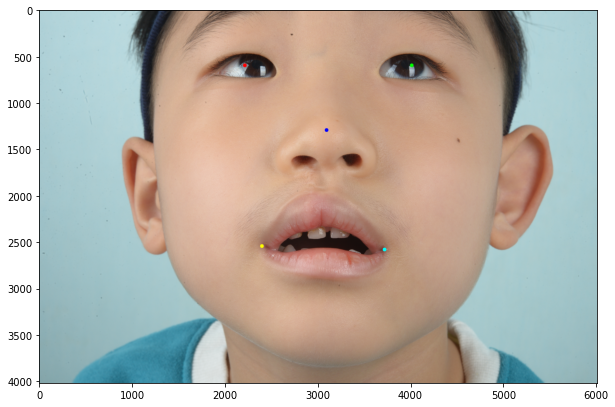

2


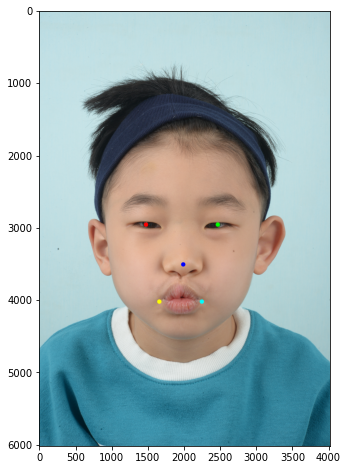

2


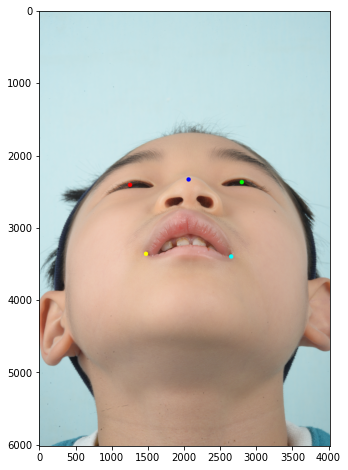

2


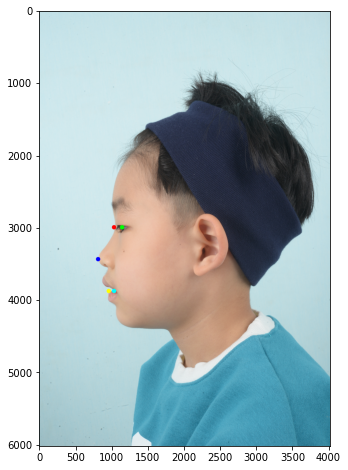

0


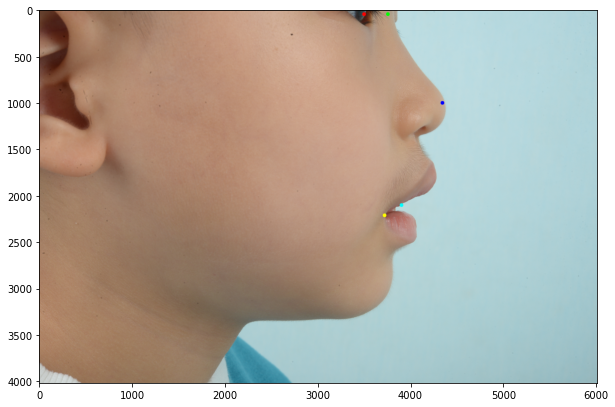

4


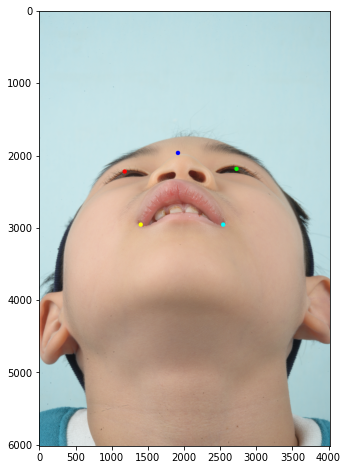

2


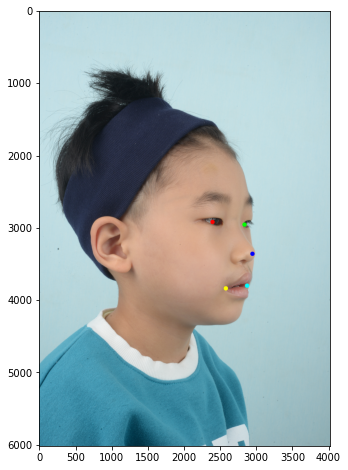

4


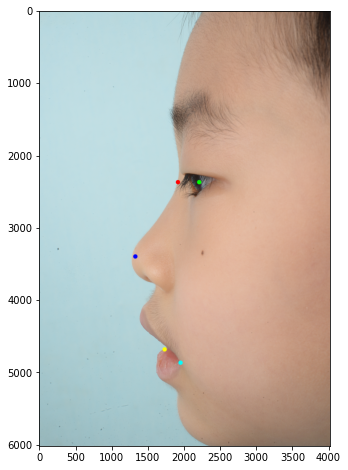

0


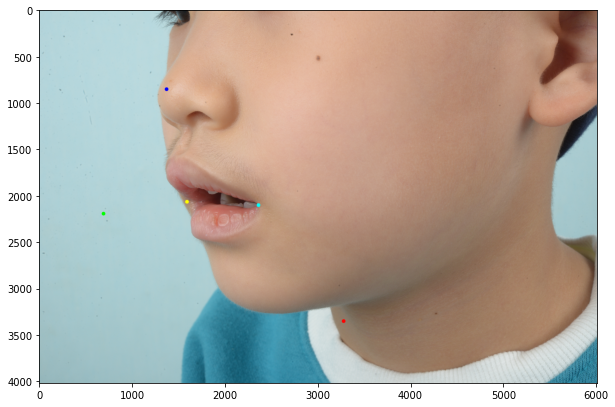

1


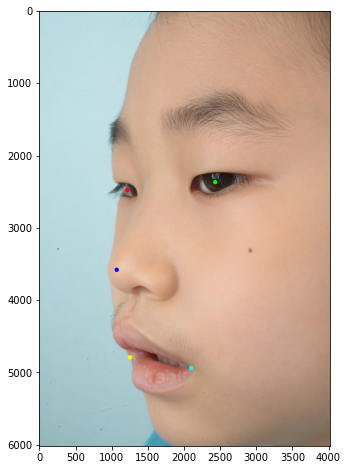

1


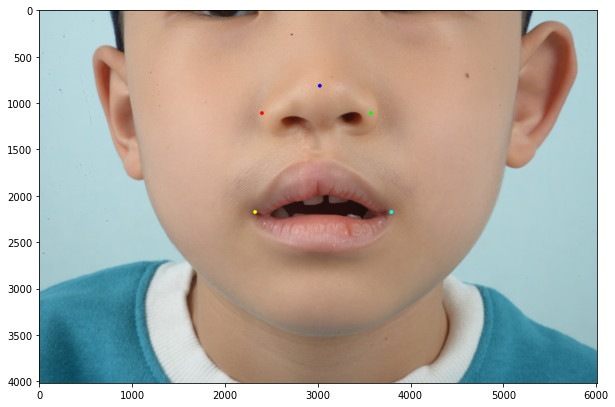

2


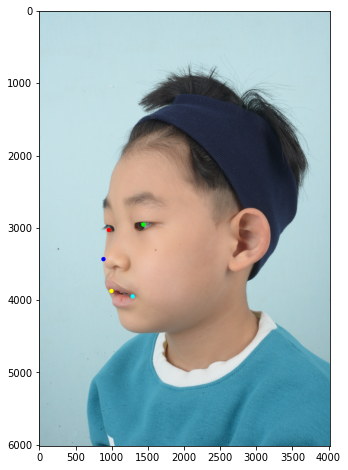

0


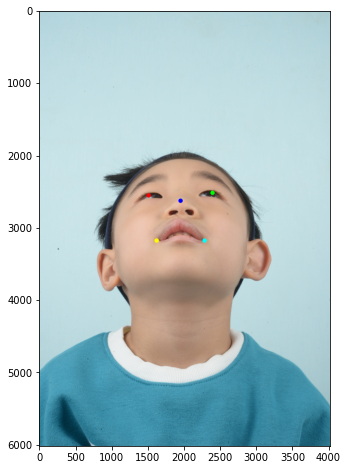

2


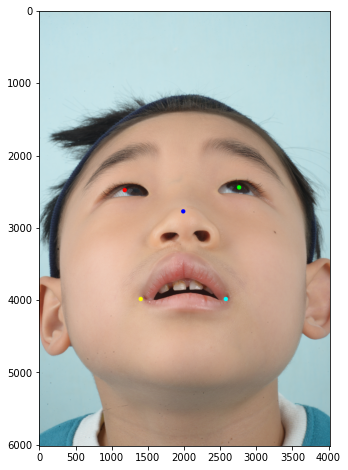

2


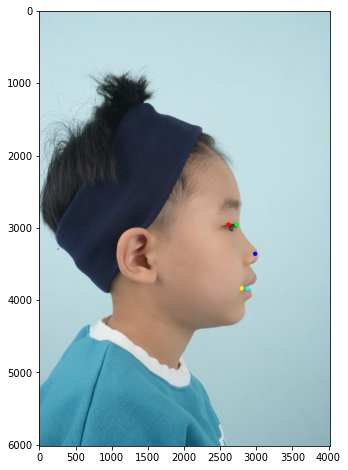

4


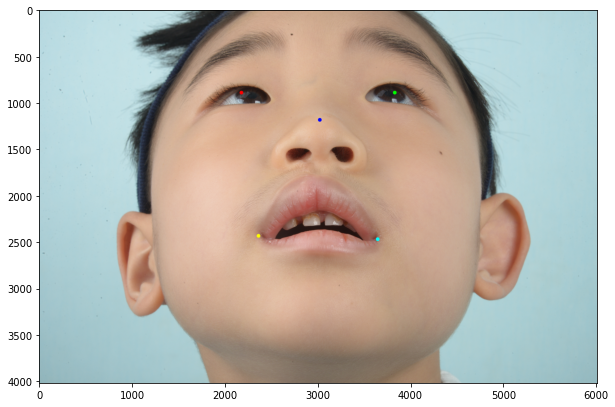

2


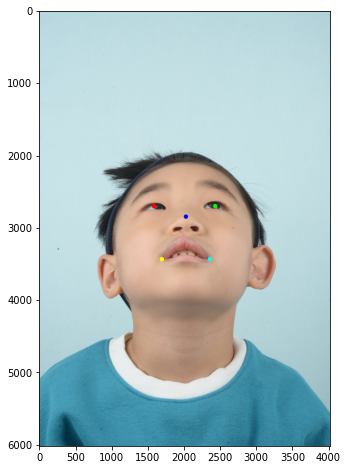

2


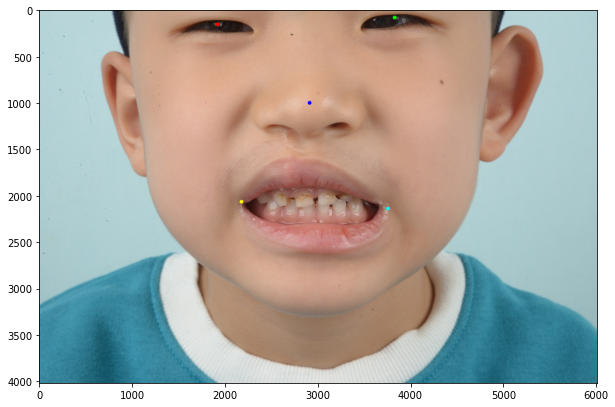

2


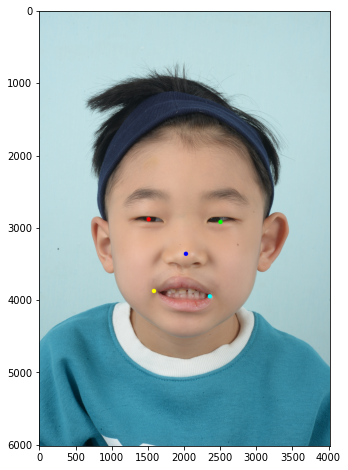

2


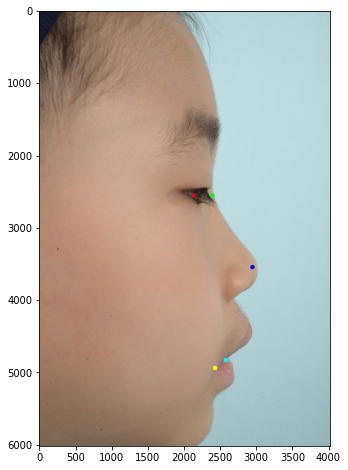

4


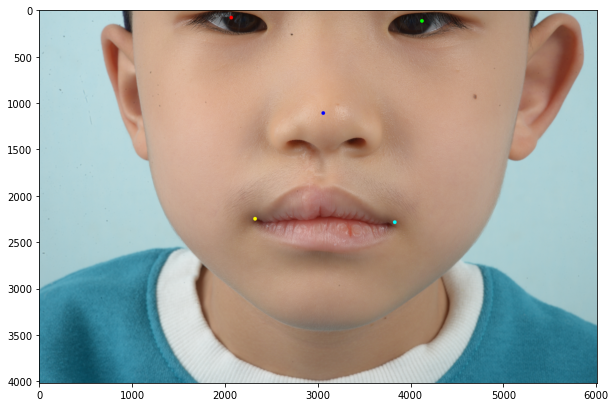

2


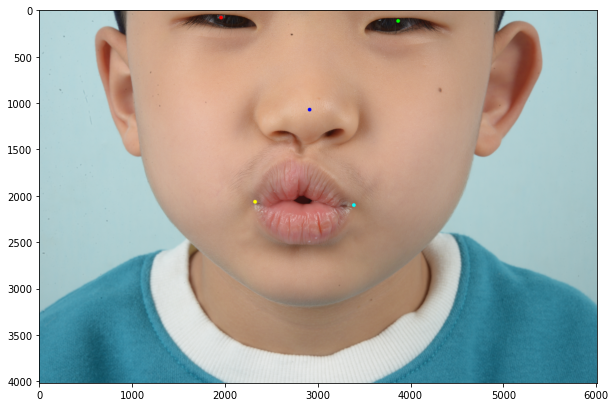

2


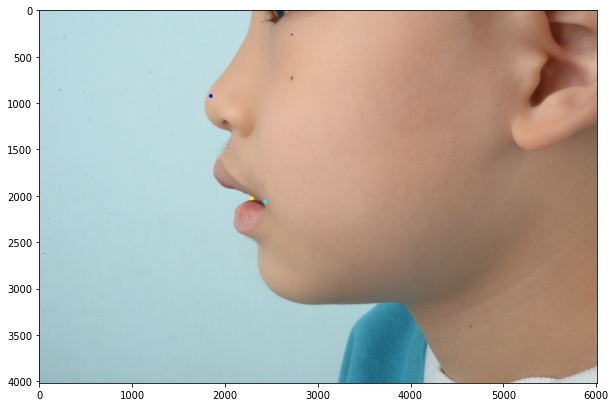

0


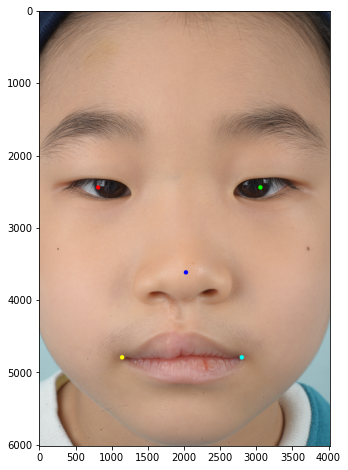

2


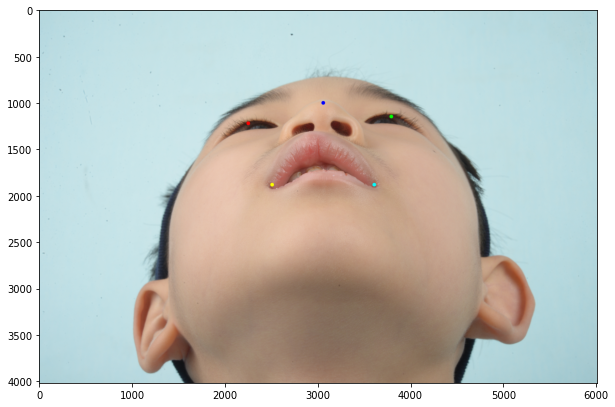

2


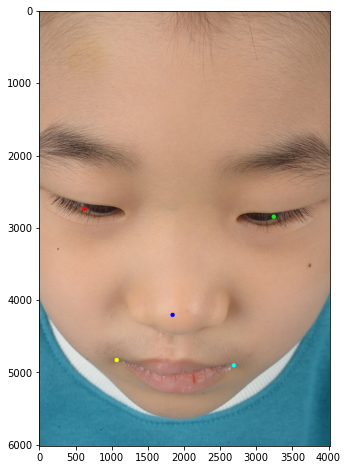

2


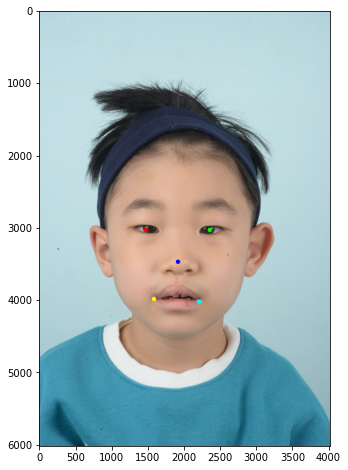

2


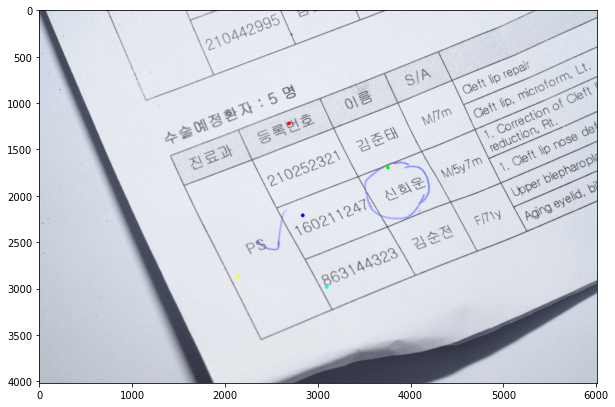

2


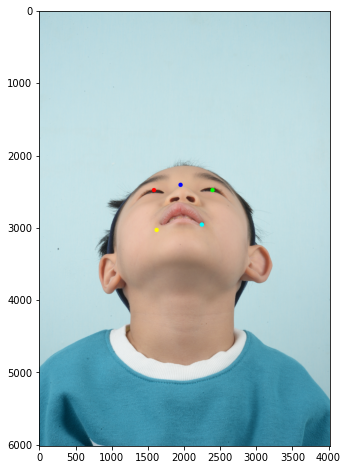

2


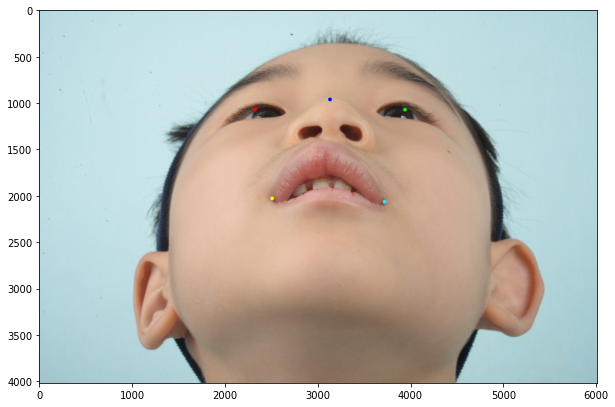

2


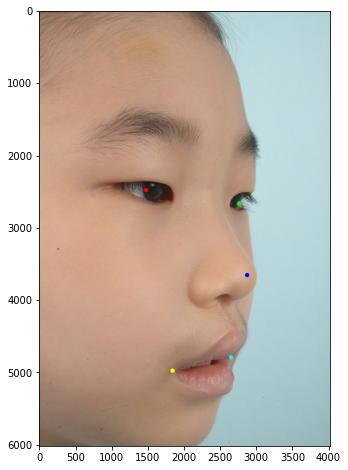

3


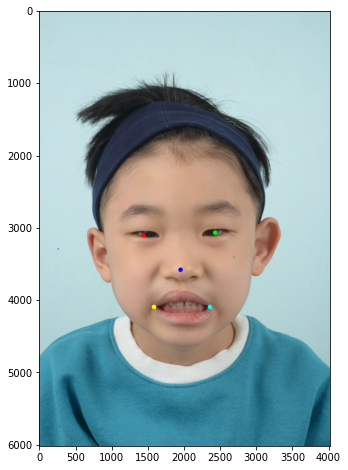

2


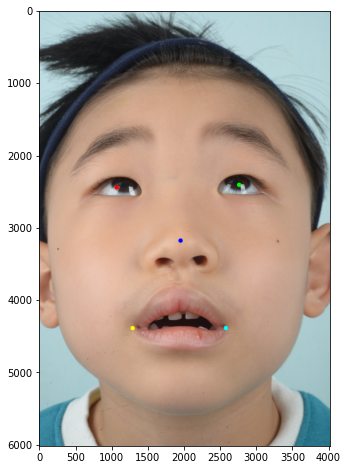

2


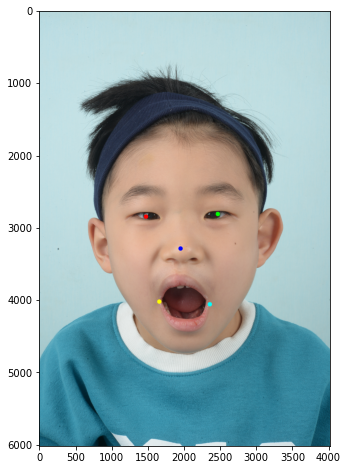

2


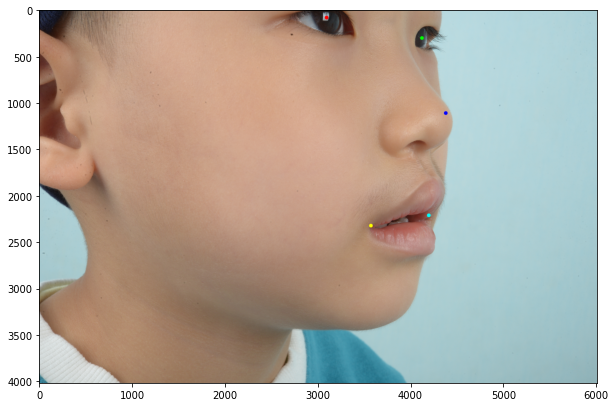

3


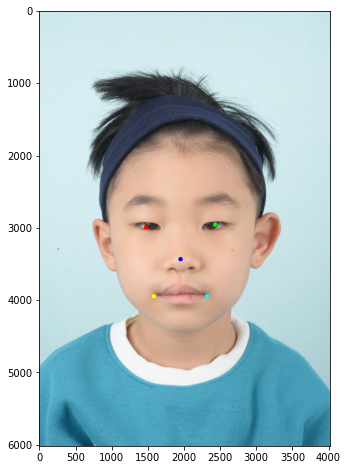

2


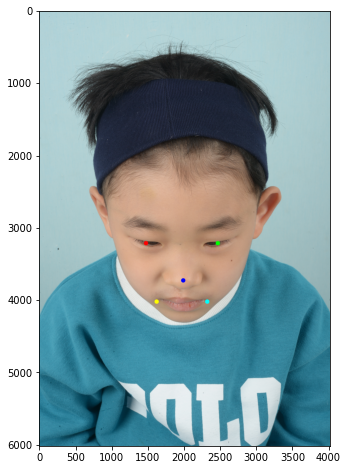

2


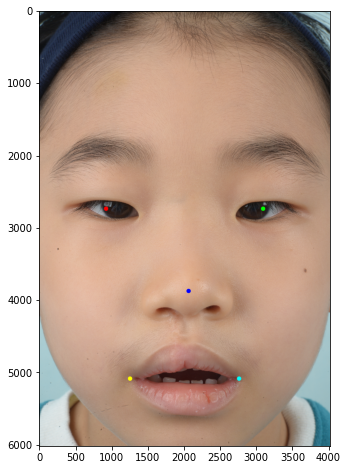

2


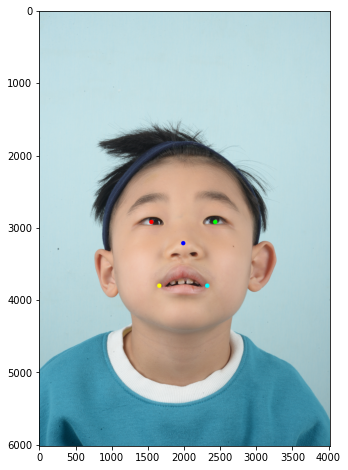

2


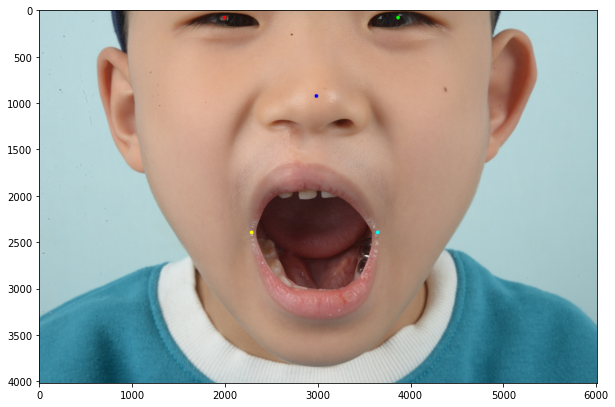

2


In [13]:
for k in imgs_dict.keys():
    CIRCLE_SIZE = imgs_dict[k]['img'].shape[0]//200
    show_landmarks(imgs_dict[k]['img'], imgs_dict[k]['lmks'], circle_size=CIRCLE_SIZE)
    print(detect_direction(imgs_dict[k]['lmks'], imgs_dict[k]['img'].shape[1]))

In [14]:
print(len(imgs_dict.keys()))

40


I split dataset to landscape/ zoom_in/ zoom_out.

In [63]:
landscape_d = {}

zoom_in_d  = {}
zoom_out_d = {}

#vertical, horizontal, center


In [64]:
distance_btw_lips = []
distance_btw_eye2lip = []
for k in imgs_dict.keys():
    width = imgs_dict[k]['width']
    height = imgs_dict[k]['height']
    lmks = imgs_dict[k]['lmks']
    
    if width > height:
        landscape_d[k] = imgs_dict[k]
    else:
        left_eye = lmks[0]
        right_eye = lmks[1]
        left_lip = lmks[3]
        right_lip = lmks[4]
        distance_btw_lips.append(abs(left_lip[0] - right_lip[0]))
        distance_btw_eye2lip.append(abs((left_lip[1]+right_lip[1])/2 - (left_eye[1]+right_eye[1])/2))

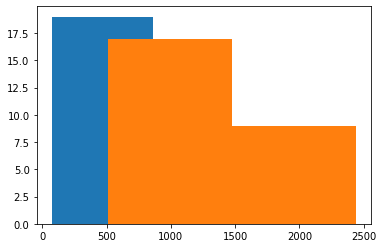

In [65]:
import matplotlib.pyplot as plt
bound_w = plt.hist(distance_btw_lips, bins=2)
bound_h = plt.hist(distance_btw_eye2lip, bins=2)
half_w = bound_w[1][1]
half_h = bound_h[1][1]

In [66]:
for k in imgs_dict.keys():
    width = imgs_dict[k]['width']
    height = imgs_dict[k]['height']
    lmks = imgs_dict[k]['lmks']
    
    left_eye  = lmks[0]
    right_eye = lmks[1]
    left_lip  = lmks[3]
    right_lip = lmks[4]
    
    if width < height:
        btw_lips = abs(left_lip[0] - right_lip[0])
        btw_eye2lip = abs((left_lip[1]+right_lip[1])/2 - (left_eye[1]+right_eye[1])/2)
        if btw_lips > half_w or btw_eye2lip > half_h:
            zoom_in_d[k] = imgs_dict[k]
        else:
            zoom_out_d[k] = imgs_dict[k]

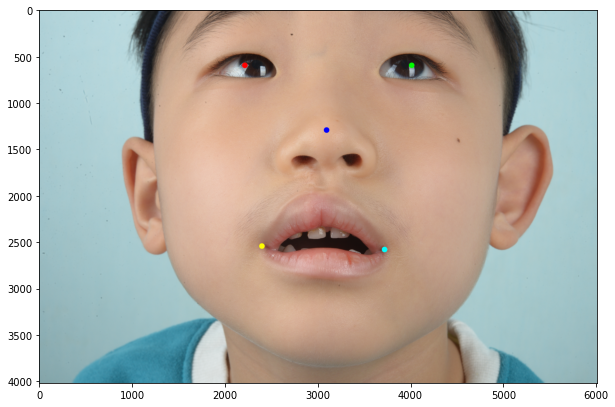

626951.5
838483.5
1465435.0
0.7477207363054849
0.5499013806706115
eye2eye 1799.000000
eye2lip 1964.500000
lip2lip 1322.000000


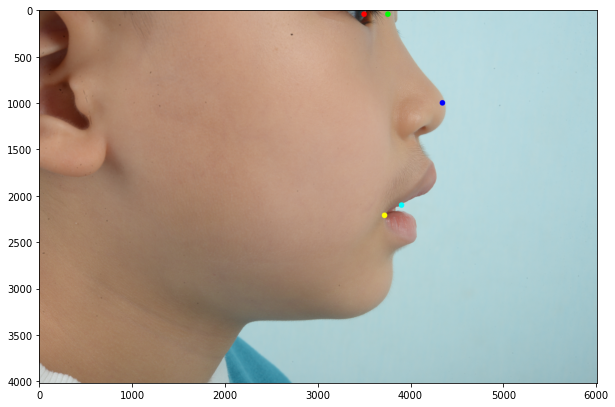

122717.5
76486.5
199204.0
1.6044334621142293
0.8261245674740484
eye2eye 257.000000
eye2lip 2111.000000
lip2lip 183.000000


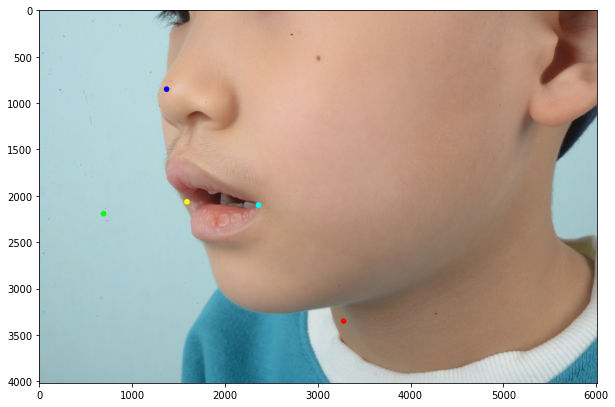

2128010.0
463266.0
2591276.0
4.593494881990044
1.5597560975609757
eye2eye 2589.000000
eye2lip 688.500000
lip2lip 771.000000


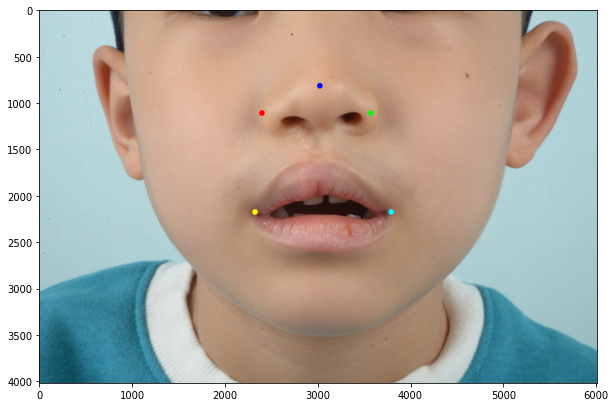

172725.0
998185.5
1170910.5
0.17303897922780886
0.2163355408388521
eye2eye 1175.000000
eye2lip 1065.000000
lip2lip 1469.000000


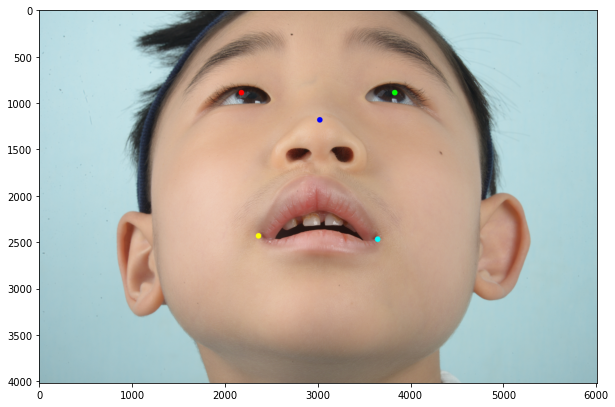

242164.5
814380.5
1056545.0
0.29736038620767563
0.23125493291239146
eye2eye 1653.000000
eye2lip 1560.000000
lip2lip 1285.000000


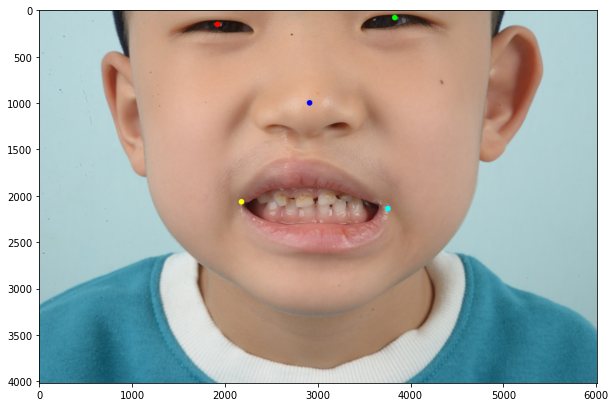

843183.0
867645.0
1710828.0
0.9718064415746072
0.8002723558783477
eye2eye 1910.000000
eye2lip 1983.000000
lip2lip 1579.000000


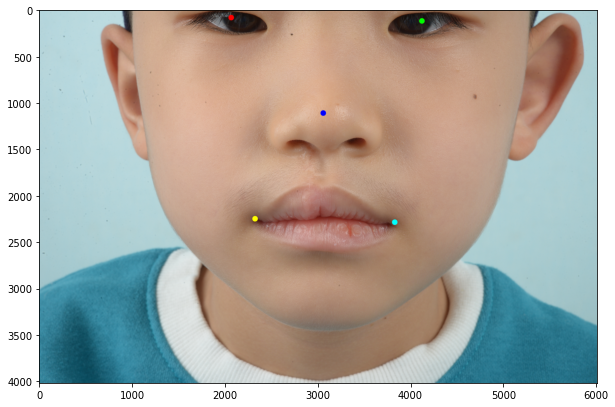

1038928.0
870511.5
1909439.5
1.193468437809265
0.8733246865542585
eye2eye 2056.000000
eye2lip 2166.500000
lip2lip 1506.000000


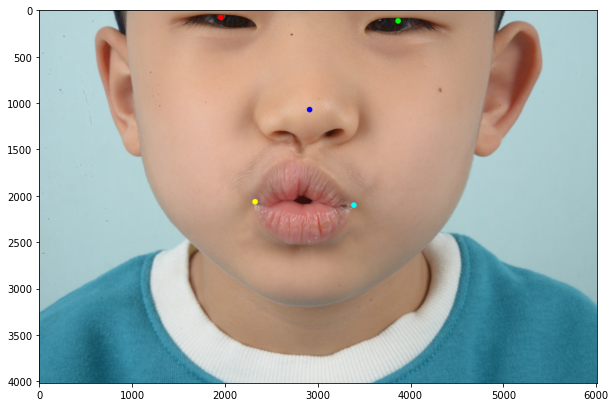

928719.5
538824.0
1467543.5
1.7236045536204772
0.9633663366336633
eye2eye 1909.000000
eye2lip 1983.000000
lip2lip 1065.000000


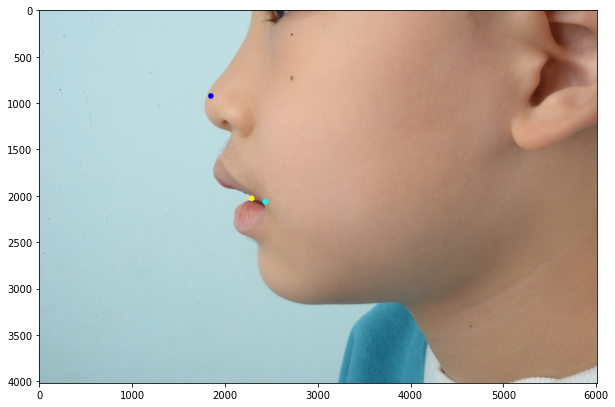

140091.0
72857.0
212948.0
1.9228214172968967
0.8505131637661758
eye2eye 294.000000
eye2lip 2073.500000
lip2lip 147.000000


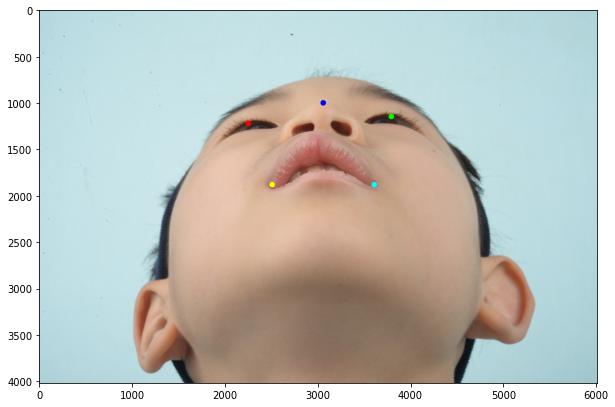

140128.0
484990.5
625118.5
0.28892937078148956
0.20828603859250852
eye2eye 1542.000000
eye2lip 697.500000
lip2lip 1101.000000


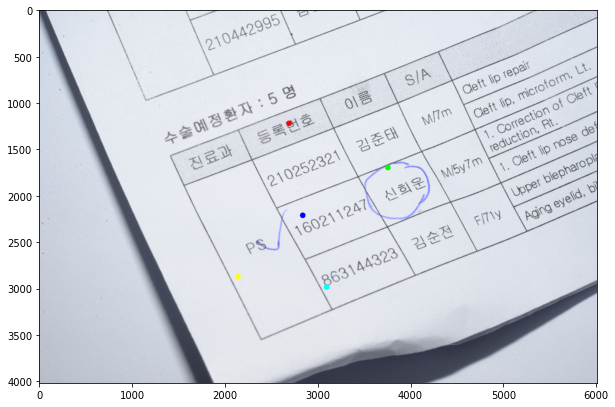

492648.0
353980.5
846628.5
1.3917376804654493
1.0502442428471737
eye2eye 1065.000000
eye2lip 1469.000000
lip2lip 954.000000


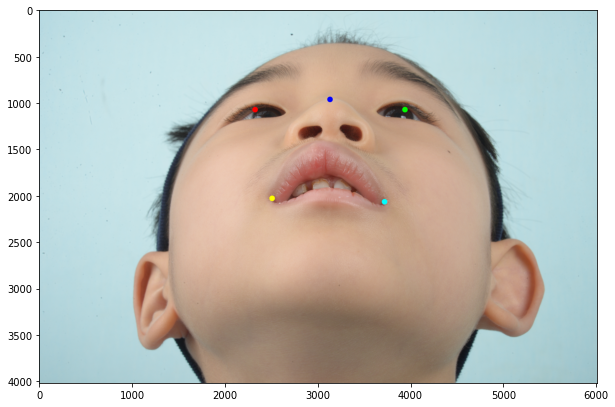

88880.0
656934.0
745814.0
0.1352951742488591
0.10152284263959391
eye2eye 1616.000000
eye2lip 973.500000
lip2lip 1212.000000


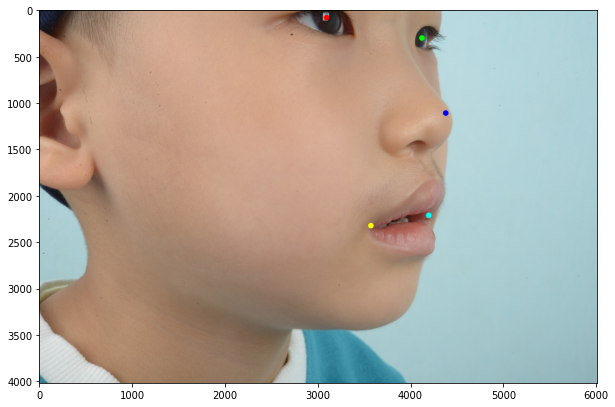

387042.0
333355.5
720397.5
1.161048790255448
0.7937743190661478
eye2eye 1028.000000
eye2lip 2074.500000
lip2lip 624.000000


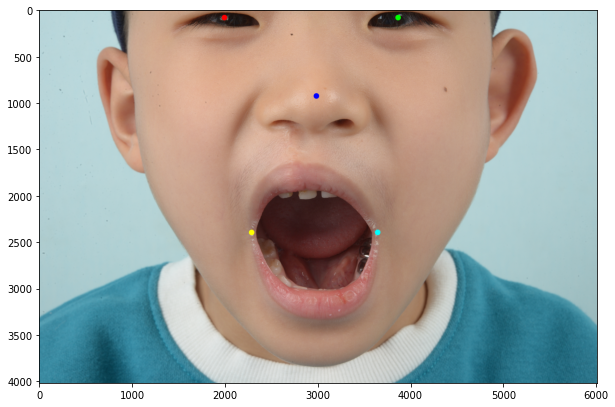

789984.0
998185.5
1788169.5
0.7914200316474242
0.5745405037440435
eye2eye 1872.000000
eye2lip 2313.000000
lip2lip 1359.000000


In [87]:
target_dict = landscape_d
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)
    lmks = target_dict[k]['lmks']
    left_eye  = lmks[0]
    right_eye = lmks[1]
    nose      = lmks[2]
    left_lip  = lmks[3]
    right_lip = lmks[4]
    
    target_dict[k]["direction"] = detect_direction(target_dict[k]['lmks'], target_dict[k]['width'])
    target_dict[k]["eye2eye"] = abs(left_eye[0] - right_eye[0])
    target_dict[k]["eye2lip"] = abs((left_eye[1]+right_eye[1])/2 - (left_lip[1]+right_lip[1])/2)
    target_dict[k]["lip2lip"] = abs(left_lip[0] - right_lip[0])

    print(target_dict[k]['top_area'])
    print(target_dict[k]['bottom_area']) 
    print(target_dict[k]['top_area'] + target_dict[k]['bottom_area'])
  
    print(target_dict[k]['top_area']/target_dict[k]['bottom_area'])
    print(abs((left_eye[1]+right_eye[1])/2 - nose[1]) / abs((left_lip[1]+right_lip[1])/2 - nose[1]))
    print("eye2eye %f" % target_dict[k]["eye2eye"] )
    print("eye2lip %f" % target_dict[k]["eye2lip"])
    print("lip2lip %f" % target_dict[k]["lip2lip"])

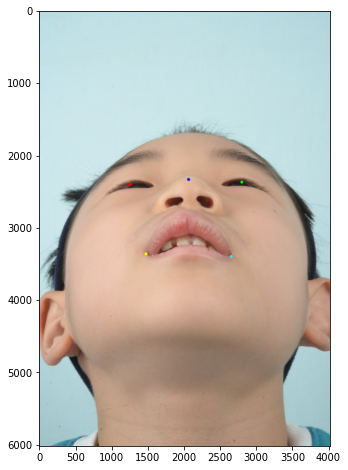

42106.0
614828.0
656934.0
0.06848419395343087
0.05303392259913999
eye2eye 1542.000000
eye2lip 991.000000
lip2lip 1175.000000


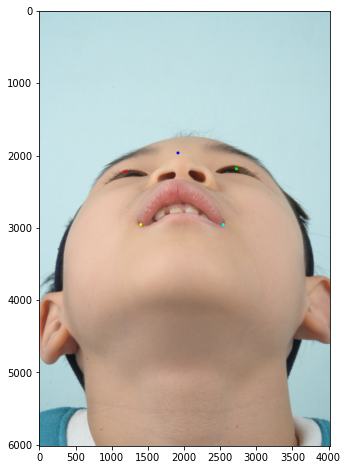

184678.0
563879.0
748557.0
0.32751352683820467
0.24066599394550958
eye2eye 1543.000000
eye2lip 752.500000
lip2lip 1138.000000


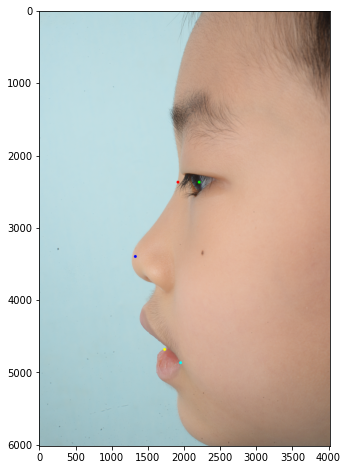

150602.0
104182.0
254784.0
1.4455664126240617
0.7465504720406682
eye2eye 293.000000
eye2lip 2405.000000
lip2lip 220.000000


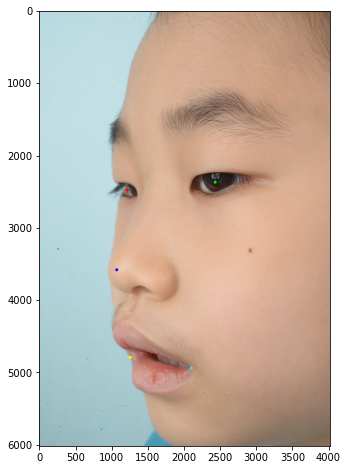

659727.0
497518.0
1157245.0
1.326036444912546
0.9007395873880888
eye2eye 1212.000000
eye2lip 2441.500000
lip2lip 844.000000


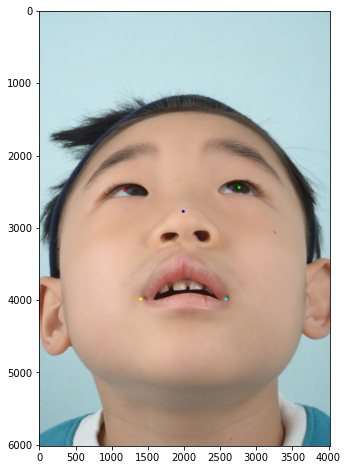

247061.0
712050.0
959111.0
0.34697142054630997
0.25783828382838286
eye2eye 1579.000000
eye2lip 1524.500000
lip2lip 1175.000000


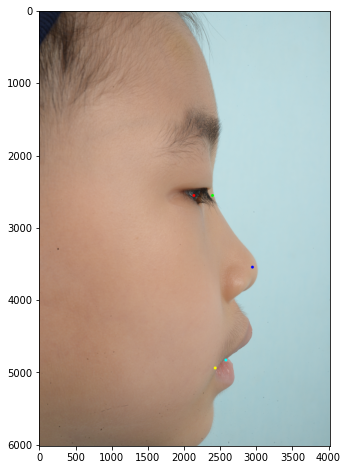

127343.5
74262.5
201606.0
1.714775290355159
0.7395522388059701
eye2eye 257.000000
eye2lip 2331.000000
lip2lip 147.000000


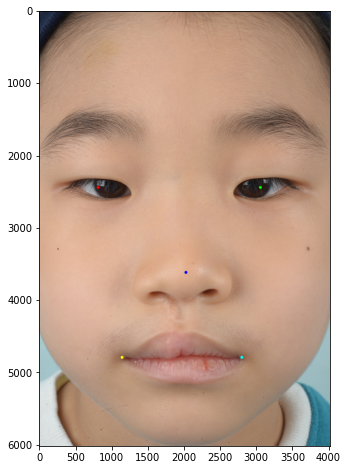

1316000.0
970550.0
2286550.0
1.3559322033898304
1.0
eye2eye 2240.000000
eye2lip 2350.000000
lip2lip 1652.000000


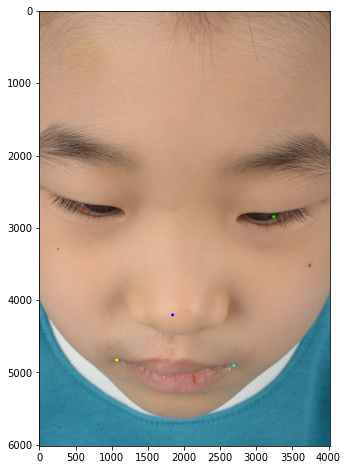

1848236.5
532719.0
2380955.5
3.46943979846786
2.1391830559757943
eye2eye 2607.000000
eye2lip 2075.000000
lip2lip 1616.000000


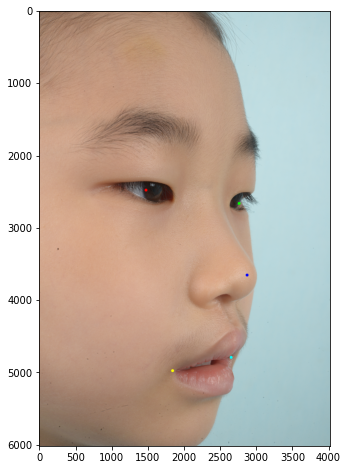

626597.5
439512.0
1066109.5
1.4256664209395875
0.8804878048780488
eye2eye 1285.000000
eye2lip 2313.000000
lip2lip 808.000000


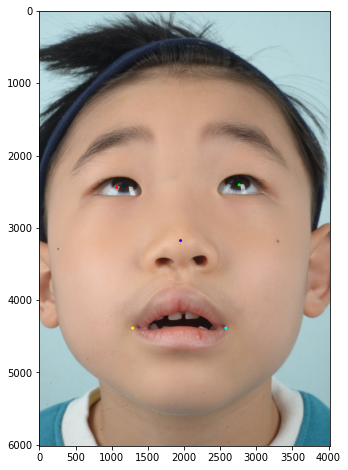

636565.5
778673.0
1415238.5
0.8175004141661519
0.6218001651527663
eye2eye 1689.000000
eye2lip 1964.000000
lip2lip 1286.000000


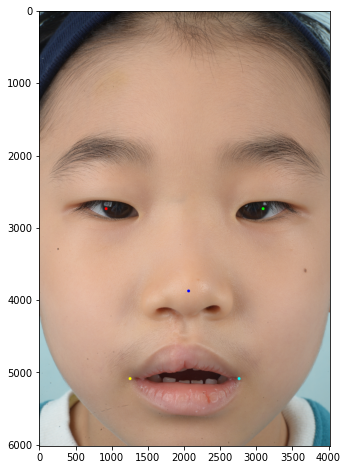

1233023.0
912030.0
2145053.0
1.351954431323531
0.9389438943894389
eye2eye 2167.000000
eye2lip 2350.000000
lip2lip 1505.000000


In [86]:
target_dict = zoom_in_d
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)
    lmks = target_dict[k]['lmks']
    left_eye  = lmks[0]
    right_eye = lmks[1]
    nose      = lmks[2]
    left_lip  = lmks[3]
    right_lip = lmks[4]
    
    target_dict[k]["direction"] = detect_direction(target_dict[k]['lmks'], target_dict[k]['width'])
    target_dict[k]["eye2eye"] = abs(left_eye[0] - right_eye[0])
    target_dict[k]["eye2lip"] = abs((left_eye[1]+right_eye[1])/2 - (left_lip[1]+right_lip[1])/2)
    target_dict[k]["lip2lip"] = abs(left_lip[0] - right_lip[0])

    print(target_dict[k]['top_area'])
    print(target_dict[k]['bottom_area']) 
    print(target_dict[k]['top_area'] + target_dict[k]['bottom_area'])
  
    print(target_dict[k]['top_area']/target_dict[k]['bottom_area'])
    print(abs((left_eye[1]+right_eye[1])/2 - nose[1]) / abs((left_lip[1]+right_lip[1])/2 - nose[1]))
    print("eye2eye %f" % target_dict[k]["eye2eye"] )
    print("eye2lip %f" % target_dict[k]["eye2lip"])
    print("lip2lip %f" % target_dict[k]["lip2lip"])

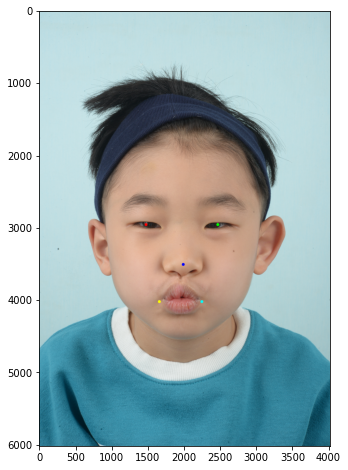

273020.5
150859.0
423879.5
1.8097727016618166
1.0719844357976653
eye2eye 991.000000
eye2lip 1065.000000
lip2lip 587.000000


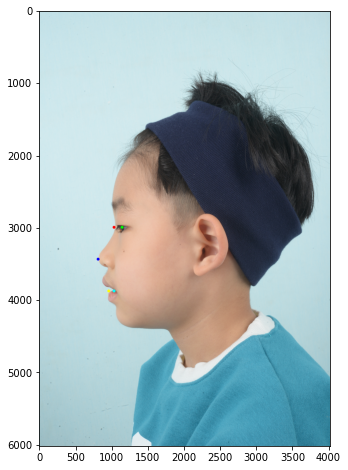

24475.5
16060.0
40535.5
1.5240037359900374
1.0022727272727272
eye2eye 111.000000
eye2lip 881.000000
lip2lip 73.000000


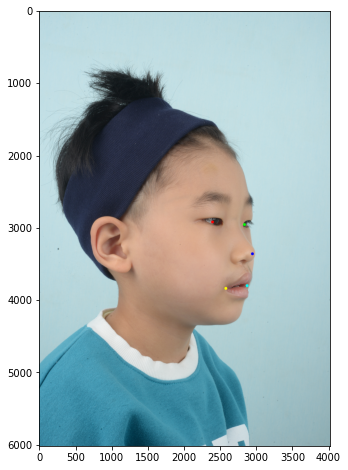

87102.0
63237.5
150339.5
1.3773789286420242
0.9183895538628944
eye2eye 441.000000
eye2lip 881.500000
lip2lip 293.000000


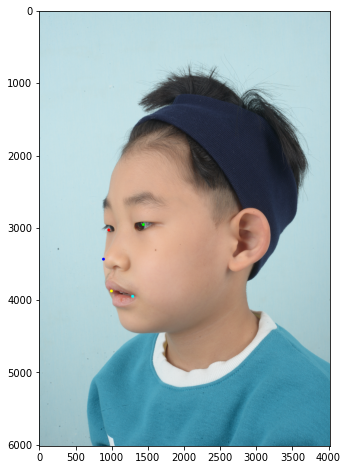

93653.0
60390.0
154043.0
1.550803113098195
0.9245283018867925
eye2eye 477.000000
eye2lip 918.000000
lip2lip 293.000000


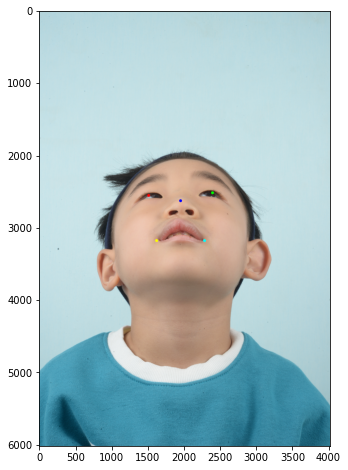

40296.5
182105.5
222402.0
0.22128107058820298
0.16606170598911071
eye2eye 881.000000
eye2lip 642.500000
lip2lip 661.000000


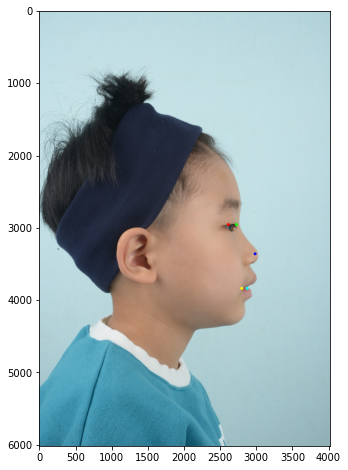

22422.0
17447.0
39869.0
1.2851493093368487
0.8451882845188284
eye2eye 111.000000
eye2lip 882.000000
lip2lip 73.000000


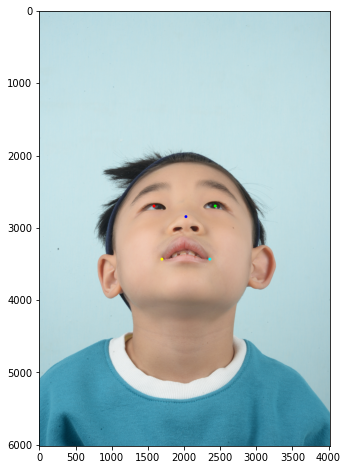

62107.5
194334.0
256441.5
0.31959152798789714
0.25
eye2eye 845.000000
eye2lip 735.000000
lip2lip 661.000000


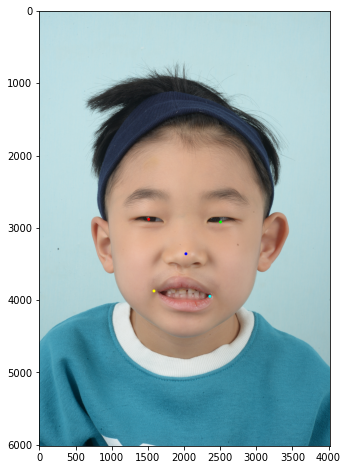

226844.5
214464.0
441308.5
1.057727637272456
0.8321234119782214
eye2eye 991.000000
eye2lip 1009.500000
lip2lip 771.000000


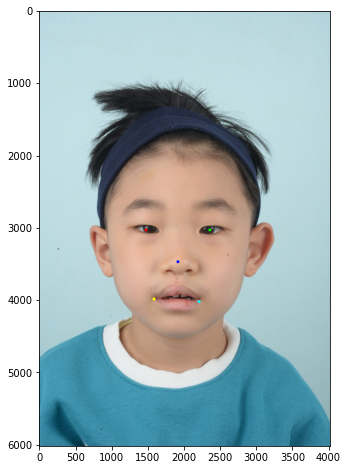

193820.0
166638.0
360458.0
1.1631200566497437
0.8255159474671669
eye2eye 881.000000
eye2lip 973.000000
lip2lip 624.000000


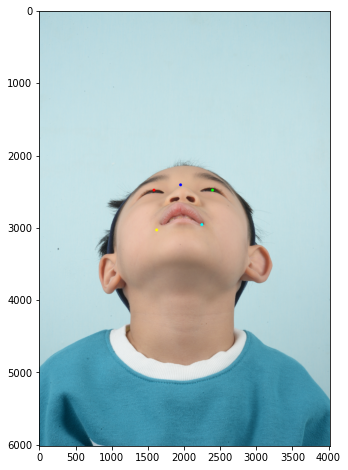

29492.0
182478.0
211970.0
0.16161948289656836
0.12436115843270869
eye2eye 808.000000
eye2lip 514.000000
lip2lip 624.000000


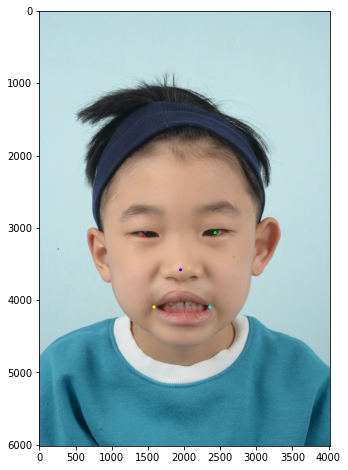

246340.0
198147.0
444487.0
1.243218418648781
0.9649805447470817
eye2eye 992.000000
eye2lip 1010.000000
lip2lip 771.000000


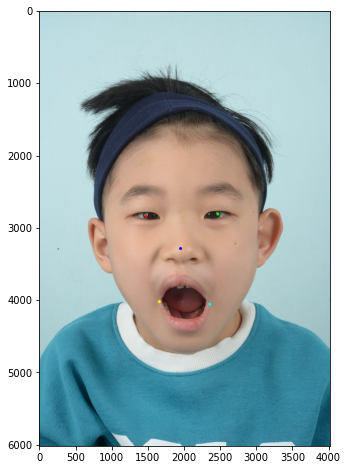

227101.5
261219.5
488321.0
0.8693895363860661
0.6099667774086379
eye2eye 991.000000
eye2lip 1211.500000
lip2lip 697.000000


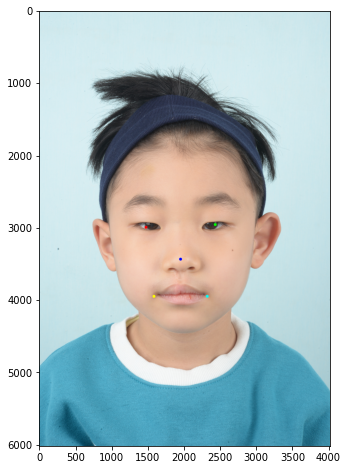

219402.0
188895.0
408297.0
1.1615024219804653
0.8939688715953308
eye2eye 955.000000
eye2lip 973.500000
lip2lip 735.000000


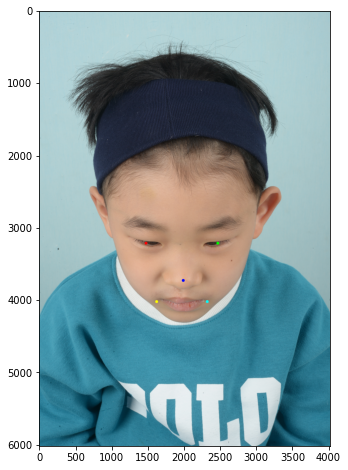

255182.5
102257.0
357439.5
2.4955015304575725
1.757679180887372
eye2eye 991.000000
eye2lip 808.000000
lip2lip 698.000000


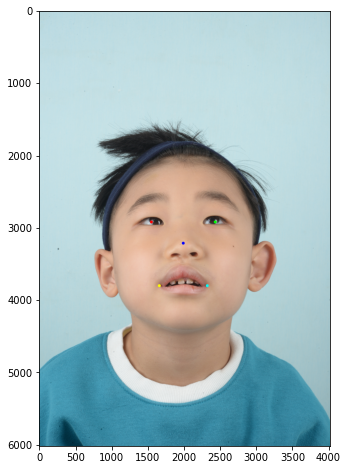

129066.5
194334.0
323400.5
0.664147807383165
0.49829931972789115
eye2eye 881.000000
eye2lip 881.000000
lip2lip 661.000000


In [85]:
target_dict = zoom_out_d
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)
    lmks = target_dict[k]['lmks']
    left_eye  = lmks[0]
    right_eye = lmks[1]
    nose      = lmks[2]
    left_lip  = lmks[3]
    right_lip = lmks[4]
    
    target_dict[k]["direction"] = detect_direction(target_dict[k]['lmks'], target_dict[k]['width'])
    target_dict[k]["eye2eye"] = abs(left_eye[0] - right_eye[0])
    target_dict[k]["eye2lip"] = abs((left_eye[1]+right_eye[1])/2 - (left_lip[1]+right_lip[1])/2)
    target_dict[k]["lip2lip"] = abs(left_lip[0] - right_lip[0])

    print(target_dict[k]['top_area'])
    print(target_dict[k]['bottom_area']) 
    print(target_dict[k]['top_area'] + target_dict[k]['bottom_area'])
  
    print(target_dict[k]['top_area']/target_dict[k]['bottom_area'])
    print(abs((left_eye[1]+right_eye[1])/2 - nose[1]) / abs((left_lip[1]+right_lip[1])/2 - nose[1]))
    print("eye2eye %f" % target_dict[k]["eye2eye"] )
    print("eye2lip %f" % target_dict[k]["eye2lip"])
    print("lip2lip %f" % target_dict[k]["lip2lip"])


In [84]:
#Now split each set to horizontal/ vertical/ origin

In [91]:
target_d = landscape_d
h_d = {}
v_d = {}
o_d = {}
for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction != 2:
        h_d[k] = target_d[k]
    else:
        v_d[k] = target_d[k]
        
target_d["horizontal"] = h_d
target_d["vertical"] = v_d


dict_keys(['DSC_3571.JPG', 'DSC_3572.JPG', 'DSC_3573.JPG'])
dict_keys(['DSC_3575.JPG', 'DSC_3570.JPG', 'DSC_3576.JPG', 'DSC_3584.JPG', 'DSC_3569.JPG', 'DSC_3586.JPG', 'DSC_3578.JPG', 'DSC_3590.JPG', 'DSC_3577.JPG', 'DSC_3583.JPG'])


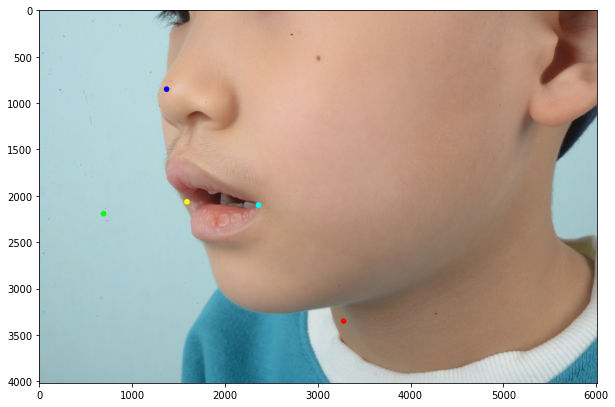

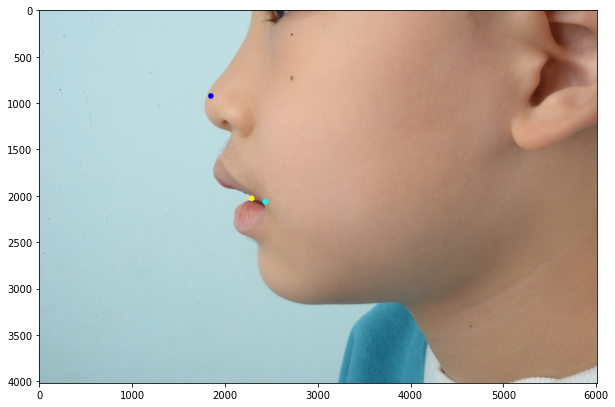

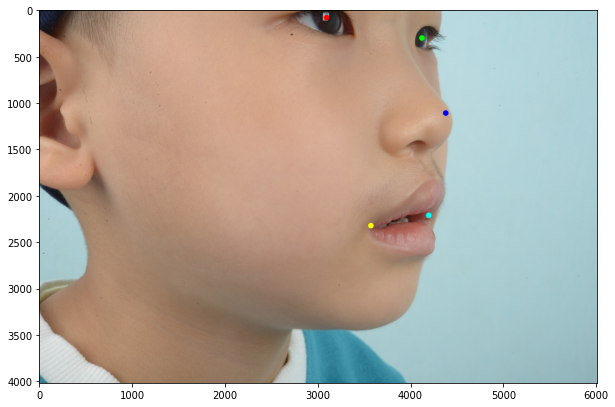

In [92]:
target_dict = h_d
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)
    

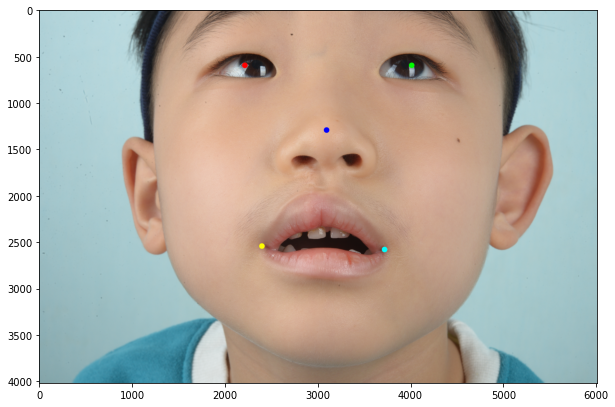

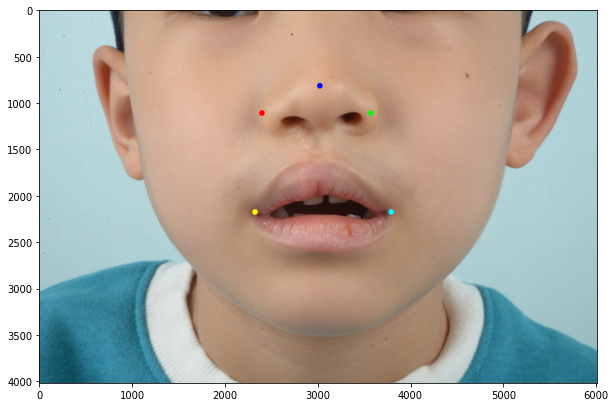

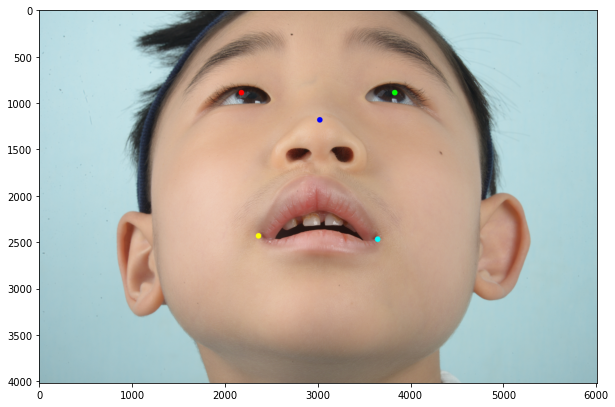

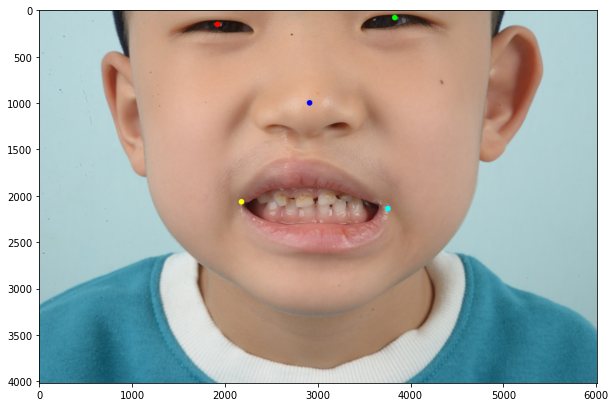

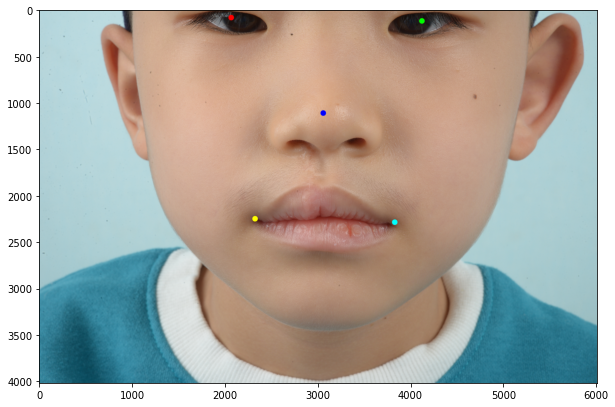

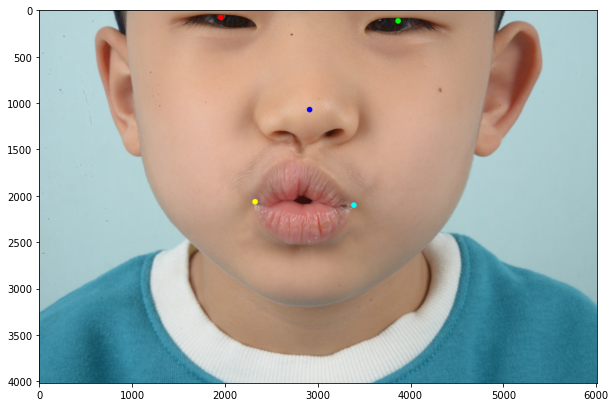

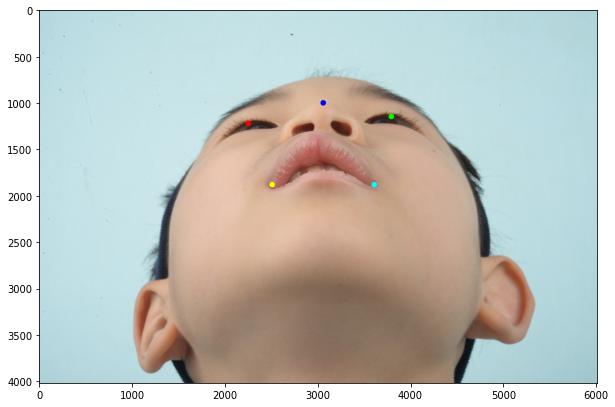

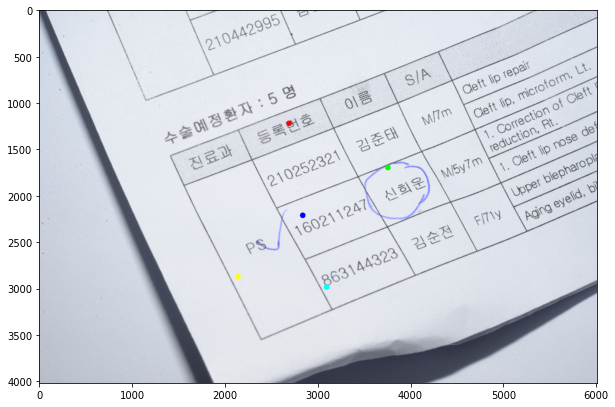

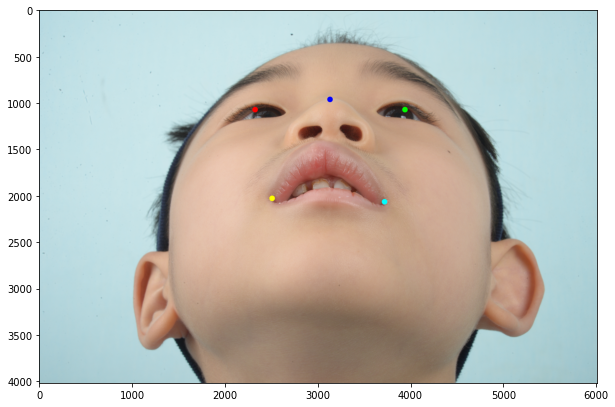

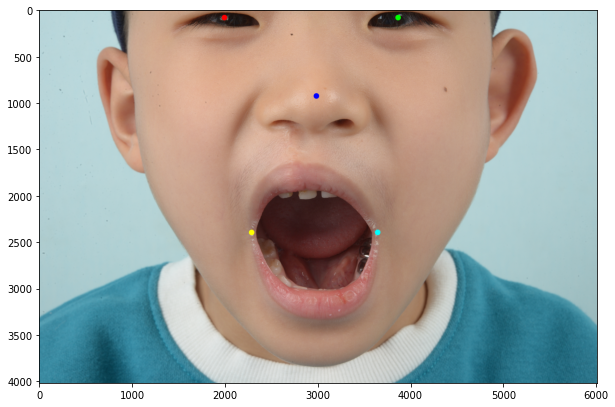

In [93]:
target_dict = v_d
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)


In [94]:
target_d = zoom_out_d
h_d = {}
v_d = {}
o_d = {}
for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction != 2:
        h_d[k] = target_d[k]
    else:
        v_d[k] = target_d[k]
        



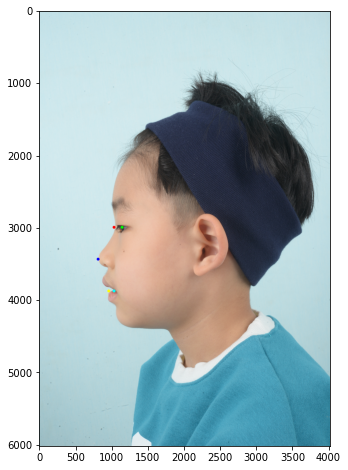

881.0


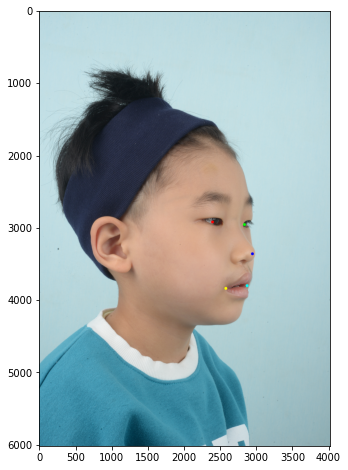

881.5


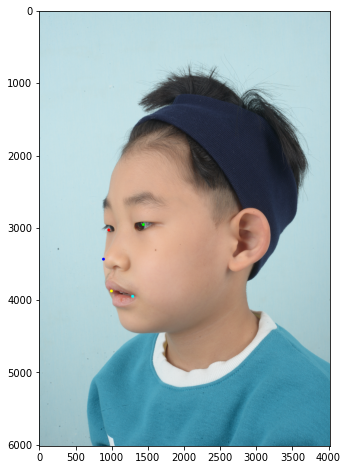

918.0


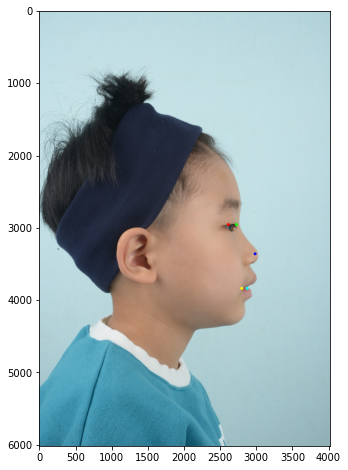

882.0


In [98]:
target_dict = h_d
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)
    print(target_dict[k]['eye2lip'])


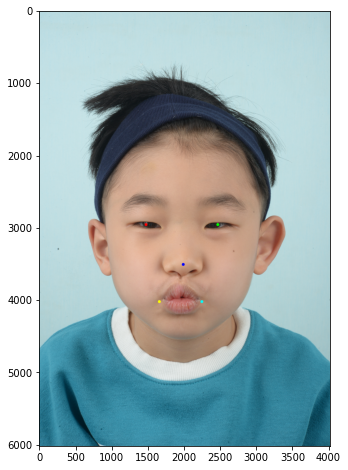

1065.0
587.0
1065.0
1.8097727016618166
1.0746720484359233
1098.5
1.0719844357976653


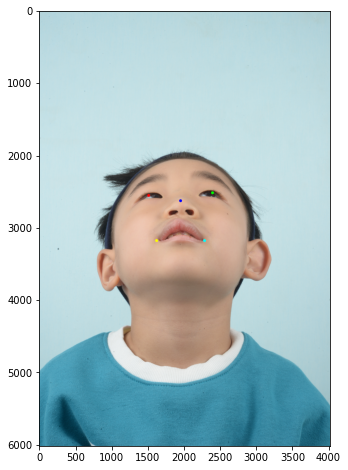

642.5
661.0
642.5
0.22128107058820298
0.7292849035187288
52785.3125
0.16606170598911071


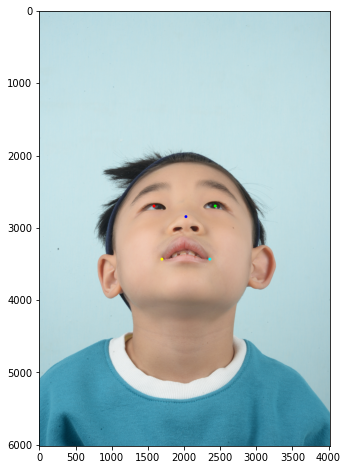

735.0
661.0
735.0
0.31959152798789714
0.8698224852071006
48710.5
0.25


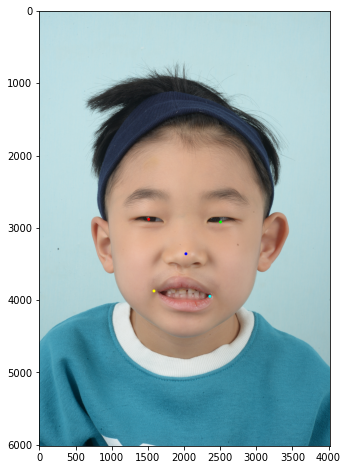

1009.5
771.0
1009.5
1.057727637272456
1.0186680121089808
3508.0625
0.8321234119782214


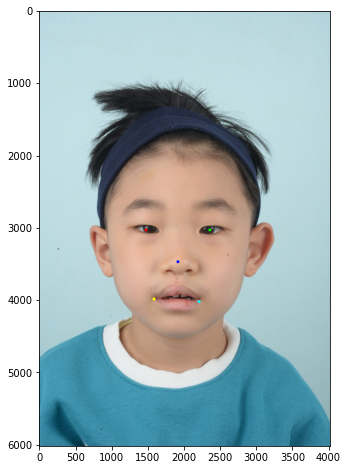

973.0
624.0
973.0
1.1631200566497437
1.1044267877412033
2257.3125
0.8255159474671669


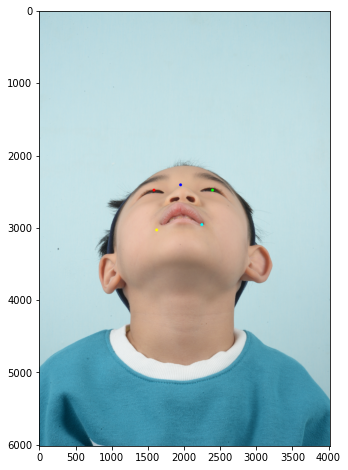

514.0
624.0
514.0
0.16161948289656836
0.6361386138613861
108990.25
0.12436115843270869


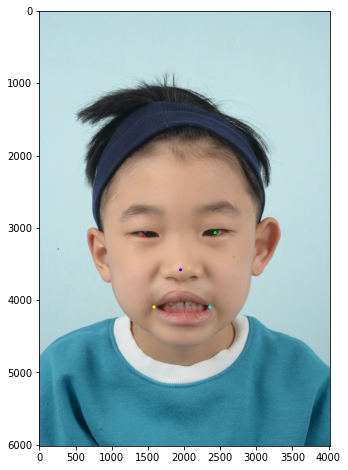

1010.0
771.0
1010.0
1.243218418648781
1.0181451612903225
81.0625
0.9649805447470817


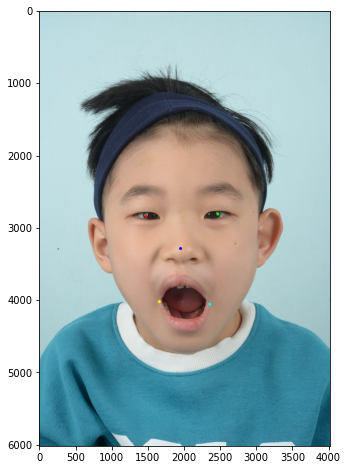

1211.5
697.0
1211.5
0.8693895363860661
1.2225025227043391
22904.5625
0.6099667774086379


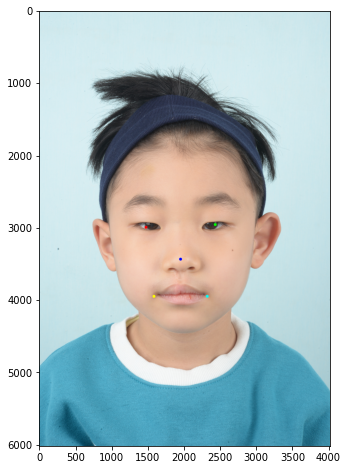

973.5
735.0
973.5
1.1615024219804653
1.0193717277486911
742.8125
0.8939688715953308


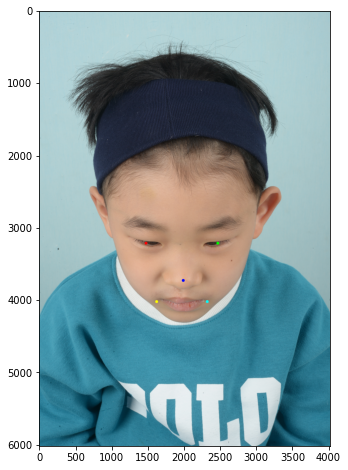

808.0
698.0
808.0
2.4955015304575725
0.8153380423814329
12654.0625
1.757679180887372


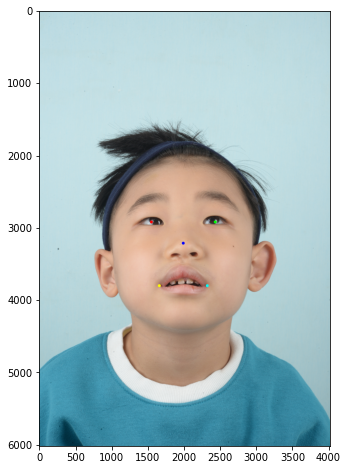

881.0
661.0
881.0
0.664147807383165
1.0
21756.5
0.49829931972789115


In [127]:
target_dict = v_d
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)
    lmks = target_dict[k]['lmks']
    left_eye  = lmks[0]
    right_eye = lmks[1]
    nose      = lmks[2]
    left_lip  = lmks[3]
    right_lip = lmks[4]
    print(target_dict[k]['eye2lip'])
    print(target_dict[k]['lip2lip'])
    print(target_dict[k]['eye2lip'])
    print(target_dict[k]['top_area']/target_dict[k]['bottom_area'])
    print(target_dict[k]['eye2lip']/target_dict[k]['eye2eye'])
    diff = (left_eye + right_eye + left_lip + right_lip)/4 - nose
    print(diff[0]**2 + diff[1]**2)
    print(abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 -nose[1]))


81.0625
DSC_3582.JPG
3.5425742574257426
[0.07198443579766534, 0.8339382940108893, 0.75, 0.16787658802177863, 0.17448405253283306, 0.8756388415672913, 0.035019455252918275, 0.3900332225913621, 0.10603112840466922, 0.757679180887372, 0.5017006802721089]


(array([6., 5.]),
 array([0.03501946, 0.45532915, 0.87563884]),
 <a list of 2 Patch objects>)

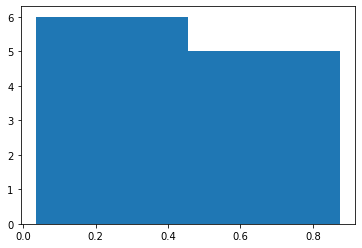

In [130]:
target_dict = v_d
diff_ratio_l = []
min_dist = 100000
for k in target_dict.keys():
    lmks = target_dict[k]['lmks']
    left_eye  = lmks[0]
    right_eye = lmks[1]
    nose      = lmks[2]
    left_lip  = lmks[3]
    right_lip = lmks[4]

    diff_t = (left_eye + right_eye + left_lip + right_lip)/4 - nose
    diff = diff_t[0]**2 + diff_t[1]**2
    if diff < min_dist:
        min_key = k
        min_dist = diff
        origin_ratio = nose[1]/target_dict[k]["eye2lip"]

for k in target_dict.keys():
    lmks = target_dict[k]['lmks']
    left_eye  = lmks[0]
    right_eye = lmks[1]
    nose      = lmks[2]
    left_lip  = lmks[3]
    right_lip = lmks[4]

    #diff_t = (left_eye + right_eye + left_lip + right_lip)/4 - nose
    #diff = diff_t[0]**2 + diff_t[1]**2
    diff_ratio_l.append(abs(1-abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 -nose[1])))
         
print(min_dist)
print(min_key)
print(origin_ratio)

print(diff_ratio_l)
plt.hist(diff_ratio_l, bins=2)

In [131]:
# updown_ratio is important to decide origin.

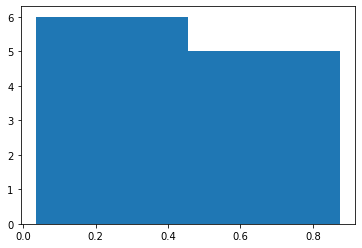

In [144]:
target_d = zoom_out_d
h_d = {}
v_d = {}
o_d = {}
_temp_l = []
for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction != 2:
        h_d[k] = target_d[k]
    else:  
        lmks = target_d[k]['lmks']
        left_eye  = lmks[0]
        right_eye = lmks[1]
        nose      = lmks[2]
        left_lip  = lmks[3]
        right_lip = lmks[4]

        _temp_l.append(abs(1-abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 -nose[1])))

boundary = plt.hist(_temp_l, bins=2)[1][1]

for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction == 2:
        lmks = target_d[k]['lmks']
        left_eye  = lmks[0]
        right_eye = lmks[1]
        nose      = lmks[2]
        left_lip  = lmks[3]
        right_lip = lmks[4]
        updown_ratio = abs(1-abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 - nose[1]))
        if updown_ratio < boundary :
            o_d[k] = target_d[k]
        else:
            v_d[k] = target_d[k]

zoom_out_split_d = {}          
zoom_out_split_d["origin"] = o_d
zoom_out_split_d["horizontal"] = h_d
zoom_out_split_d["vertical"] = v_d


dict_keys(['DSC_3575.JPG', 'DSC_3571.JPG', 'DSC_3570.JPG', 'DSC_3576.JPG', 'DSC_3584.JPG', 'DSC_3569.JPG', 'DSC_3586.JPG', 'DSC_3572.JPG', 'DSC_3578.JPG', 'DSC_3590.JPG', 'DSC_3577.JPG', 'DSC_3573.JPG', 'DSC_3583.JPG'])


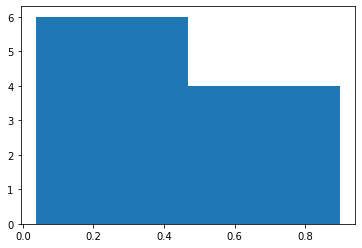

In [145]:
target_d = landscape_d
print(target_d.keys())
h_d = {}
v_d = {}
o_d = {}
_temp_l = []
for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction != 2:
        h_d[k] = target_d[k]
    else:  
        lmks = target_d[k]['lmks']
        left_eye  = lmks[0]
        right_eye = lmks[1]
        nose      = lmks[2]
        left_lip  = lmks[3]
        right_lip = lmks[4]

        _temp_l.append(abs(1-abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 -nose[1])))

boundary = plt.hist(_temp_l, bins=2)[1][1]

for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction == 2:
        lmks = target_d[k]['lmks']
        left_eye  = lmks[0]
        right_eye = lmks[1]
        nose      = lmks[2]
        left_lip  = lmks[3]
        right_lip = lmks[4]
        updown_ratio = abs(1-abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 - nose[1]))
        if updown_ratio < boundary :
            o_d[k] = target_d[k]
        else:
            v_d[k] = target_d[k]

landscape_split_d = {}          
landscape_split_d["origin"] = o_d
landscape_split_d["horizontal"] = h_d
landscape_split_d["vertical"] = v_d

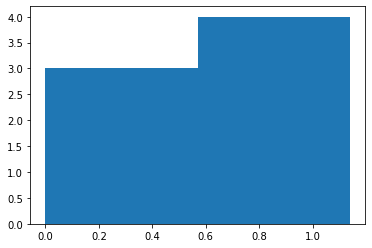

In [147]:
target_d = zoom_in_d
h_d = {}
v_d = {}
o_d = {}
_temp_l = []
for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction != 2:
        h_d[k] = target_d[k]
    else:  
        lmks = target_d[k]['lmks']
        left_eye  = lmks[0]
        right_eye = lmks[1]
        nose      = lmks[2]
        left_lip  = lmks[3]
        right_lip = lmks[4]

        _temp_l.append(abs(1-abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 -nose[1])))

boundary = plt.hist(_temp_l, bins=2)[1][1]

for k in target_d.keys():
    target = target_d[k]
    direction = target["direction"]
    if direction == 2:
        lmks = target_d[k]['lmks']
        left_eye  = lmks[0]
        right_eye = lmks[1]
        nose      = lmks[2]
        left_lip  = lmks[3]
        right_lip = lmks[4]
        updown_ratio = abs(1-abs((left_eye[1]+right_eye[1])/2 - nose[1])/abs((left_lip[1]+right_lip[1])/2 - nose[1]))
        if updown_ratio < boundary :
            o_d[k] = target_d[k]
        else:
            v_d[k] = target_d[k]

zoom_in_split_d = {}          
zoom_in_split_d["origin"] = o_d
zoom_in_split_d["horizontal"] = h_d
zoom_in_split_d["vertical"] = v_d

In [148]:
#landscape_split_d/ zoom_in_split_d/ zoom_out_split_d

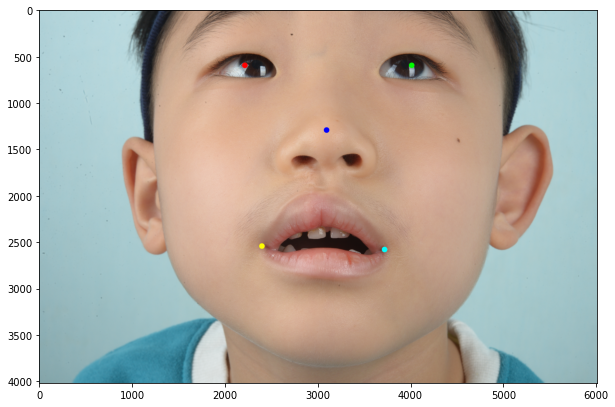

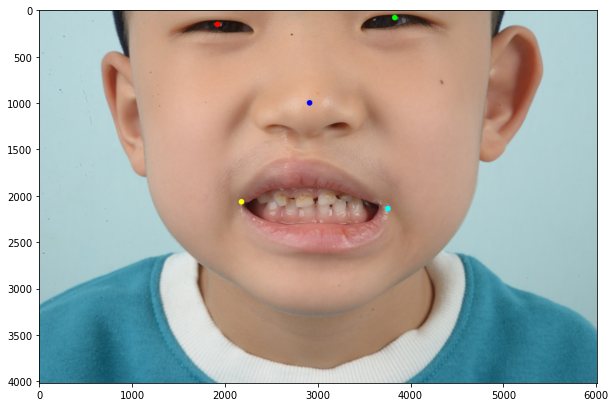

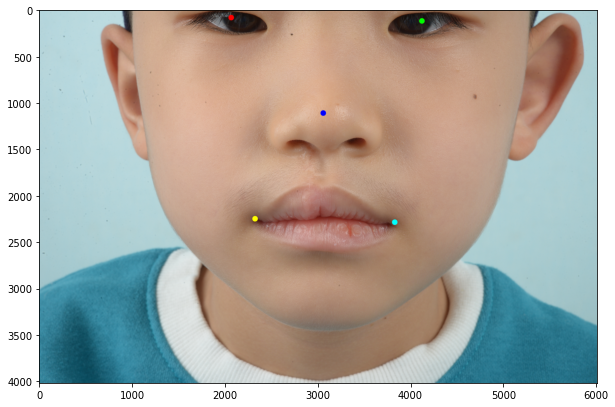

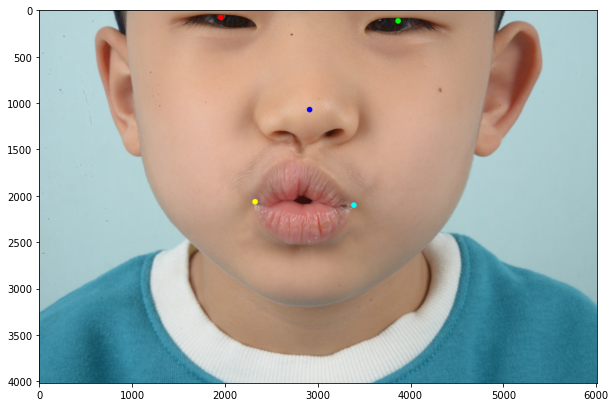

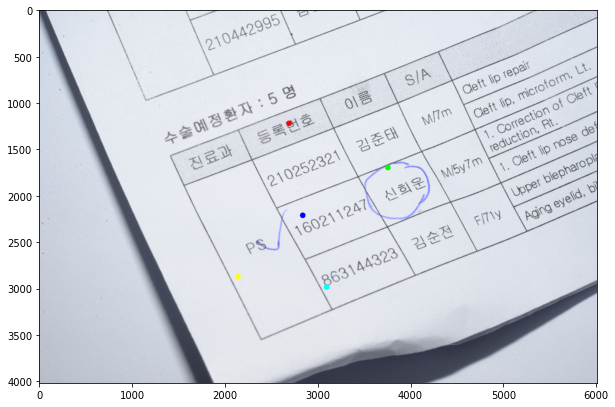

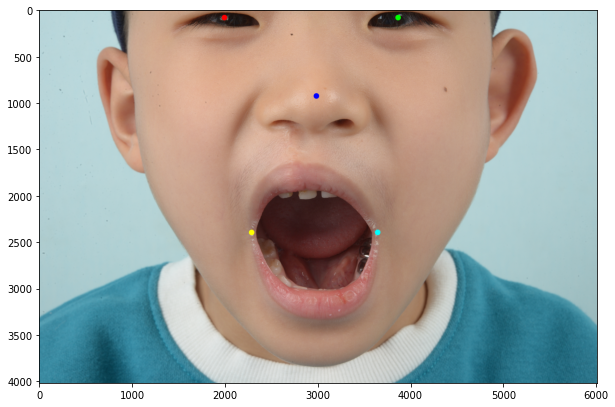

In [149]:
target_dict = landscape_split_d["origin"]
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)

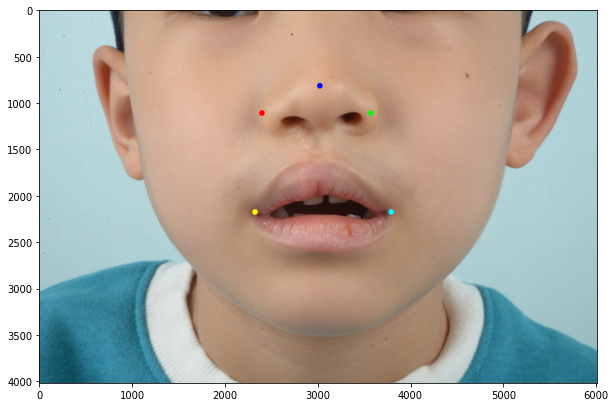

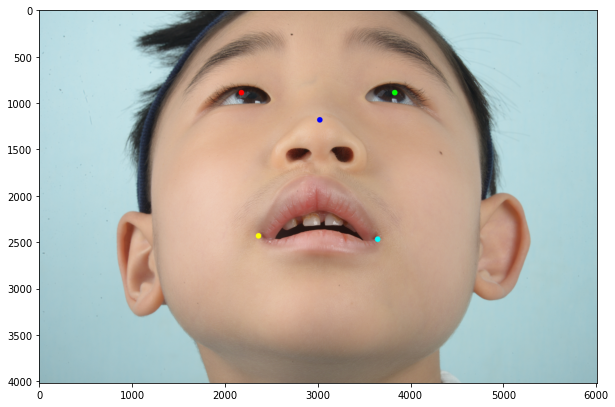

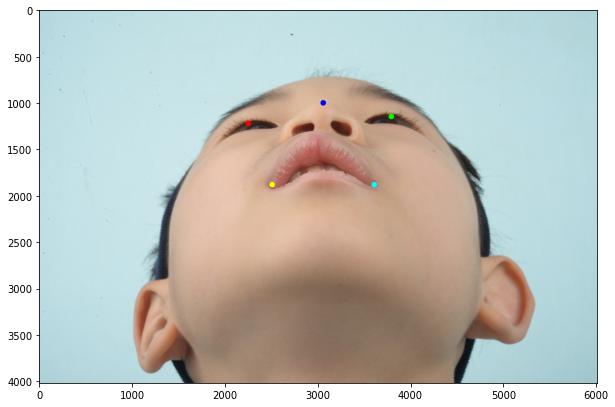

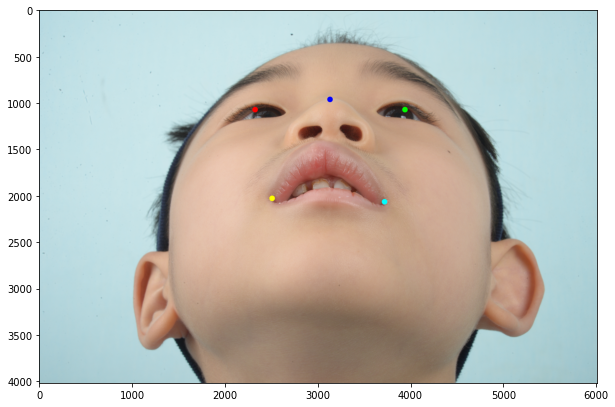

In [150]:
target_dict = landscape_split_d["vertical"]
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)

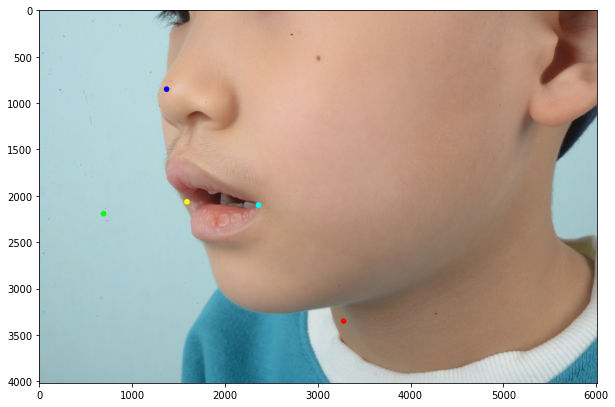

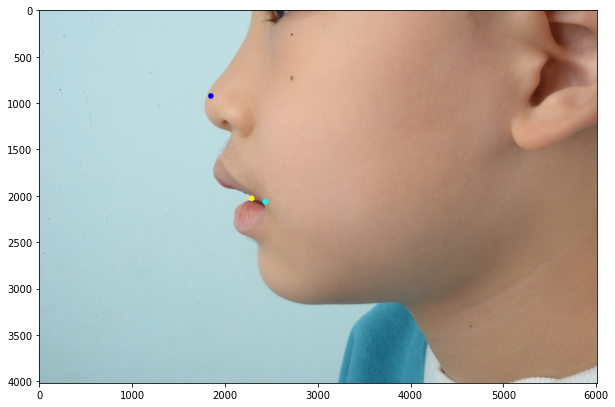

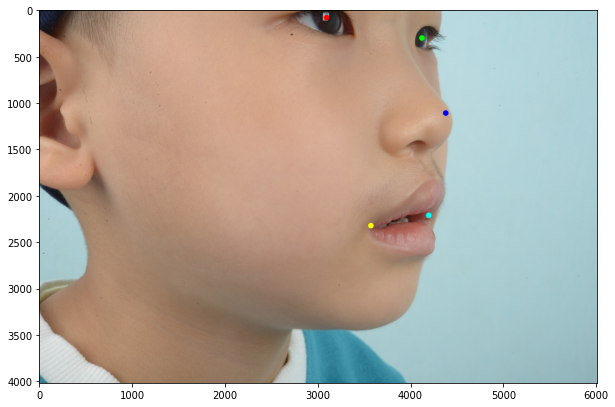

In [151]:
target_dict = landscape_split_d["horizontal"]
for k in target_dict.keys():
    CIRCLE_SIZE = target_dict[k]['width']//200
    show_landmarks(target_dict[k]['img'], target_dict[k]['lmks'], circle_size=CIRCLE_SIZE)